<a href="https://colab.research.google.com/github/ArnaudDavyMM/Time-Series-Analyis/blob/master/Store_Sales_Time_Series_%26_Forecast_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Overview
We are going to divide this project into 2 big parts such as Part 1 and Part 2.
Part 1 will focus on Exploratory Data Analysis and Feature Engenering.
Part 2 will be focused on Time Series Analysis and Forecast. Regarding Time Series Analysis and Forecast Data Scientists use various algorithm depending on data at hand,The following are the most used ones:

*   Stas Models (ARIMA, SARIMA)
*   Ensemble algorithms (XBoost, Random Forest, etc)
*   Facebook Prophet
*   Deep Learning or Neural Networks algorithms (RNN, CNN, LSTM)

We are going to try all of them in this project and see which one performs better for this project and the type of data we have at our disposal.

# Part 1

In this section we are going to focus on the Exploratory Data Analys of our Stores Sales data before performing various Time Series Analysis and Forecastiong algorithms. Here are the step we are going to follow:



1.   Install Dependencies
2.   Import Libraries and Dependencies
3.   Import or load dataset
4.   EDA
          .Get Info data type, how many observations & variables (rows & columns)
          .Check Missing Values in dataset
          .Check Duplicates in dataset
          .Sumary Descriptive
          .Exploratory Analysis on variables
          .Data vizualization
          .Features Engineering
          .Deep dive into Data Analysis (Trend, Pattern, Seasonality if any)
          .Correlation

End of Part 1.






## Install Dependencies

In [ ]:
!pip install -U statsmodels
!pip install pmdarima
!pip install prophet
!pip install --upgrade plotly

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import warnings
warnings.simplefilter('ignore')   
warnings.filterwarnings('ignore', category = DeprecationWarning) 
warnings.filterwarnings('ignore', category = UserWarning) 

## Importing Libraries & Dependencies

In [ ]:
# Data Manipulation & Preprocessing
import numpy as np
import pandas as pd
import itertools
from datetime import datetime
import datetime
from sklearn.preprocessing import *

# Data Visualization
import seaborn as sbn
import matplotlib.pyplot as plt
sbn.set(rc={'figure.figsize':(12,8)})

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from pandas.plotting import scatter_matrix

# Time series
import statsmodels.api as sm
from statsmodels.tsa.api import *
from statsmodels.tsa.stattools import *
from statsmodels.graphics.tsaplots import *
from statsmodels.tsa.statespace.varmax import *
from statsmodels.tsa.seasonal import *

from prophet import Prophet
from prophet.diagnostics import cross_validation
from prophet.diagnostics import performance_metrics
from prophet.plot import * # (plot_plotly,plot_components_plotly,add_changepoints_to_plot,plot_cross_validation_metric)


# EVALUATION METRICS
from sklearn.metrics import *
from sklearn.model_selection import *

## 1. Load Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount =True)

Mounted at /content/drive


In [ ]:
train_df = pd.read_csv('/content/drive/MyDrive/Retail_train_data.csv', 
                       parse_dates =['Date'],
                       infer_datetime_format = True,
                       low_memory = False)

In [ ]:
print('Training data Rows : %s and Columns : %s ' % (str(train_df.shape[0]) ,str(train_df.shape[1])))

Training data Rows : 982644 and Columns : 9 


## 2. EDA (Exploratory Data Analysis)

In [ ]:
# Train dataset info
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982644 entries, 0 to 982643
Data columns (total 9 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Store          982644 non-null  int64         
 1   DayOfWeek      982644 non-null  int64         
 2   Date           982644 non-null  datetime64[ns]
 3   Sales          982644 non-null  int64         
 4   Customers      982644 non-null  int64         
 5   Open           982644 non-null  int64         
 6   Promo          982644 non-null  int64         
 7   StateHoliday   982644 non-null  object        
 8   SchoolHoliday  982644 non-null  int64         
dtypes: datetime64[ns](1), int64(7), object(1)
memory usage: 67.5+ MB


## View or Display Dataset

In [ ]:
train_df.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,2,2015-06-30,5735,568,1,1,0,0
1,2,2,2015-06-30,9863,877,1,1,0,0
2,3,2,2015-06-30,13261,1072,1,1,0,1
3,4,2,2015-06-30,13106,1488,1,1,0,0
4,5,2,2015-06-30,6635,645,1,1,0,0


In [ ]:
train_df.tail()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
982639,1111,2,2013-01-01,0,0,0,0,a,1
982640,1112,2,2013-01-01,0,0,0,0,a,1
982641,1113,2,2013-01-01,0,0,0,0,a,1
982642,1114,2,2013-01-01,0,0,0,0,a,1
982643,1115,2,2013-01-01,0,0,0,0,a,1


## Check Missing Values

In [ ]:
train_df.isna().sum()

Store            0
DayOfWeek        0
Date             0
Sales            0
Customers        0
Open             0
Promo            0
StateHoliday     0
SchoolHoliday    0
dtype: int64

## Check Duplicates

In [ ]:
# LET'S CHECK DUPLICATES IN DATASET
print('train_df duplicated : {}'.format(train_df.duplicated().sum()))

train_df duplicated : 0


## Summary Statistics

In [ ]:
# SUMMARY STATISTICS
round(train_df.describe(),3)

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday
count,982644.000,982644.000,982644.000,982644.000,982644.000,982644.000,982644.000
mean,558.445,3.998,5760.843,632.770,0.829,0.380,0.172
std,321.910,2.000,3857.573,465.401,0.377,0.485,0.377
min,1.000,1.000,0.000,0.000,0.000,0.000,0.000
25%,280.000,2.000,3705.000,403.000,1.000,0.000,0.000
50%,558.000,4.000,5731.000,609.000,1.000,0.000,0.000
75%,838.000,6.000,7847.000,838.000,1.000,1.000,0.000
max,1115.000,7.000,41551.000,7388.000,1.000,1.000,1.000


In [ ]:
train_df['Date'].min(), train_df['Date'].max()

(Timestamp('2013-01-01 00:00:00'), Timestamp('2015-06-30 00:00:00'))

In [ ]:
train_df.sort_values('Date', inplace =True, ascending =True)

In [ ]:
train_df.tail()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
745,746,2,2015-06-30,8082,598,1,1,0,0
746,747,2,2015-06-30,10850,770,1,1,0,0
747,748,2,2015-06-30,9862,654,1,1,0,1
741,742,2,2015-06-30,11505,996,1,1,0,1
0,1,2,2015-06-30,5735,568,1,1,0,0


In [ ]:
print('There are a total of',train_df['Store'].unique().shape[0], 'stores')

There are a total of 1115 stores


In [ ]:
train_df['DayOfWeek'].sort_values().unique()

array([1, 2, 3, 4, 5, 6, 7])

In [ ]:
set(train_df['StateHoliday'])

{'0', 'a', 'b', 'c'}

In [ ]:
train_df['StateHoliday'].unique()

array(['a', '0', 'b', 'c'], dtype=object)

In [ ]:
train_df['StateHoliday'].value_counts()

0    951594
a     20260
b      6690
c      4100
Name: StateHoliday, dtype: int64

In [ ]:
train_df['SchoolHoliday'].unique()

array([1, 0])

In [ ]:
train_df['SchoolHoliday'].value_counts()

0    813700
1    168944
Name: SchoolHoliday, dtype: int64

## 2.1 Data Visualization

In [ ]:
# PIE CHART FOR UNIQUE CLASS
values = train_df['Open'].value_counts() # Counting the unique values frequency
labels = train_df['Open'].unique().tolist() # Creating the unique value labels
explode = (0.1,0) # explode the first slice

# Creating pie chart using plotly pie
fig =go.Figure(data =[go.Pie(values = values, labels =labels, pull =[0.1,0])])
fig.update_layout(title_text ='Percentage Distribution per StateHoliday Unique Class')
fig.show()
print(values)

1    814204
0    168440
Name: Open, dtype: int64


In [ ]:
values = train_df['StateHoliday'].value_counts() # Counting the unique values frequency
labels = train_df['StateHoliday'].unique().tolist() # Creating the unique value labels
explode = (0.1,0) # explode the first slice

# Creating pie chart using plotly pie
fig =go.Figure(data = [go.Pie(values = values, labels =labels, pull =[0.1,0])])
fig.update_layout(title_text ='Percentage Distribution per StateHoliday Unique Class')
fig.show()

In [ ]:
values = train_df['SchoolHoliday'].value_counts() # Counting the unique values frequency
labels = train_df['SchoolHoliday'].unique().tolist() # Creating the unique value labels
explode = (0.1,0) # explode the first slice

# Creating pie chart using plotly pie
fig =go.Figure(data = [go.Pie(values = values, labels =labels, pull =[0.1,0])])
fig.update_layout(title_text ='Percentage Distribution per SchoolHoliday Unique Class')
fig.show()

In [ ]:
# create the bins
counts, bins = np.histogram(train_df.Sales, bins =range(0, 41551, 550))
bins = 0.5 * (bins[:-1] + bins[1:])

fig = px.bar(x = bins, y = counts, labels ={'x':'Sales', 'y': 'Count'}, title ='Distribution for Sales')
fig.update_layout(bargap = 0.05)
fig.show()

In [ ]:
fig = px.histogram(train_df, x="Sales", marginal = 'box',nbins = 55, title ='Histogram of Sales')
fig.show()

From the graphs above. it's clear to state that our target variable is asymetric (not normaly distributed) and right skewed with outliers over 14,264 (14.264K).
As I don't get further explainations regarding the outliers form the person in charge with domain knowledge on the matter. I'm going to perform a log transformation to see if there will be any improvement before decidind to remove the outliersee if there is any change. Otherwise, I am going to remove outliers.

## Features Engineering

In [ ]:
set(train_df.StateHoliday)

{'0', 'a', 'b', 'c'}

In [ ]:
# transform categorical variable to numeric using map method
mappings = {0: 0, '0': 0, 'a': 1, 'b': 2, 'c': 3}
train_df['StateHoliday']  = train_df['StateHoliday'].map(mappings)

**Adding features for better analysis***

In [ ]:
train_df['day'] = train_df['Date'].dt.strftime('%a') 
train_df['week'] = train_df['Date'].dt.isocalendar().week
train_df['month'] = train_df['Date'].dt.strftime('%b') 
train_df['quater'] = train_df['Date'].dt.quarter
train_df['year'] = train_df['Date'].dt.year


Always double check the result after any transformation 

In [ ]:
train_df[['Date','year']].sample(5)

,Date,year
335515,2014-08-11,2014
65294,2015-05-03,2015
807356,2013-06-07,2013
120540,2015-03-14,2015
152695,2015-02-14,2015


In [ ]:
train_df[['Date','month']].sample(5)

,Date,month
866868,2013-04-14,Apr
94000,2015-04-07,Apr
707018,2013-09-05,Sep
360011,2014-07-15,Jul
948320,2013-01-31,Jan


In [ ]:
train_df[['Date','week']].sample(5)

,Date,week
170600,2015-01-28,5
745313,2013-08-01,31
756846,2013-07-22,30
379616,2014-06-25,26
854812,2013-04-25,17


In [ ]:
train_df[['DayOfWeek','day']].sample(5)

,DayOfWeek,day
847534,4,Thu
86130,2,Tue
667011,5,Fri
586754,7,Sun
971805,4,Thu


In [ ]:
print(f'The shape after addind features : {train_df.shape}')

The shape after addind features : (982644, 14)


In [ ]:
train_df.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,day,week,month,quater,year
982643,1115,2,2013-01-01,0,0,0,0,1,1,Tue,1,Jan,1,2013
981908,379,2,2013-01-01,0,0,0,0,1,1,Tue,1,Jan,1,2013
981907,378,2,2013-01-01,0,0,0,0,1,1,Tue,1,Jan,1,2013
981906,377,2,2013-01-01,0,0,0,0,1,1,Tue,1,Jan,1,2013
981905,376,2,2013-01-01,0,0,0,0,1,1,Tue,1,Jan,1,2013


## 3. Data Analysis

In [ ]:
# TOTAL NUMBER OF TIMES STORES WERE CLOSED
print('There are',train_df[(train_df.Open == 0)].shape[0], 'days the stores were closed')

There are 168440 days the stores were closed


In [ ]:
# TOTAL NUMBER OF TIME STORES WERE OPENED
print('There are',train_df[(train_df.Open == 1)].shape[0], 'days the stores were Opened')

There are 814204 days the stores were Opened


In [ ]:
# HOW MANY TIMES STORES DID NOT SALES
print('there are',train_df[train_df['Sales'] == 0].shape[0], 'days the stores did not sales')

there are 168494 days the stores did not sales


In [ ]:
# HOW MANY TIMES STORES SALES
print('there are ',train_df[train_df['Sales'] != 0].shape[0], 'days the stores have sales')

there are  814150 days the stores have sales


In [ ]:
# TOTAL NUMBER OF DAY THE STORES WERE OPENED AND HAVE SALES (SALES != 0)
print('there are ',train_df[(train_df.Sales != 0) & (train_df.Open == 1)].shape[0], 'days the stores were opened and did not sale')

there are  814150 days the stores were opened and did not sale


In [ ]:
# TOTAL NUMBER OF DAY THE STORES WERE OPENED BUT DID NOT SALES (SALES = 0)
print('there are ',train_df[(train_df.Sales == 0) & (train_df.Open == 1)].shape[0], 'days the stores were opened and did not sale')

there are  54 days the stores were opened and did not sale


### ***Conclusion***

From 203 to 2015 (3 years time frame):
*   There were 168440 times stores were closed
*   There were 814204 times stores were opened.
*   There were 168494 times stores did not sales
*   There were 814150 times stores did sales
*   There were 54 times stores were open but did not sale that may be caused by an external maintenance or repairs in the store or refurbishment.

From the result, we can conclude that lots of stores don't sale some days including weekdays amd weekends too. It seems like the store was close that's may be the reason Sales = 0.





In [ ]:
DS_grp = train_df.groupby('day', as_index = False)[['Sales']].mean()

fig = px.bar(DS_grp, x= 'day', y='Sales', text_auto='.2s', color ='day', title='Average Sales trend per Day')
fig.update_traces(textfont_size = 12, textangle = 0, textposition = "outside", cliponaxis = False)
fig.show()

From the grap above, we can clearly conclude that:

*   On weekdays Monday has the highest sales on average per day follows by Tuesday, Friday and Wednesday respectively
*   On weekends Saturday has the highest sales on average whereas Sunday has the lowest sales on average either on weekdays or weekdays. It seems near all stores were closed either by Holidays or inventories, or maintenance.


In [ ]:
DC_grp = train_df.groupby('day', as_index = False)[['Customers']].mean()

fig =px.line(DC_grp, x= 'day', y ='Customers', title ='Average customers trend per Day', markers = True)
fig.show()


From the grap above, we can clearly conclude that:

*   On weekdays Monday has the most day visited by Customers on average per day follows by Tuesday, Friday and Wednesday respectively
*   On weekends Saturday is the most visited by Customers day on average whereas Sunday is the least crowded on average either on weekdays or weekdays. 

It seems near all stores were closed either by Holidays or inventories, or maintenance. Let's check which Stores are opened on Sundays and how many are there?

In [ ]:
# stores which are opened on Sundays
train_df[(train_df.Open == 1) & (train_df.day== 'Sun')]['Store'].unique()

array([ 353,  310,  335,  494,  530,  423,   85,  274,  262,  259,  948,
        863, 1097,  682,  676,  578,  562,  769,  733,  512, 1045,  877,
       1099,  122,  209,  299,  524,  453,  732,  931,  867,  433, 1081])

In [ ]:
print('There are :', len(train_df[(train_df.Open == 1) & (train_df.DayOfWeek == 7)]['Store'].unique()), 'opened on Sundays')

There are : 33 opened on Sundays


In [ ]:
WS_grp = train_df.groupby('week', as_index = False)['Sales'].mean()

fig =px.line(WS_grp, x = 'week', y ='Sales', title ='Average customers trend per Week', markers = True)
fig.show()

As seen above the 51st week has the highest sales on average follows by week 49th, week 27th, week 31th and week 45 respectively.

In [ ]:
WC_grp = train_df.groupby('week', as_index = False)['Customers'].mean()

fig =px.line(WC_grp, x= 'week', y='Customers', title='Average customers trend per Week', markers = True)
fig.show()


The graph above follow the same trend and pattern with sales.

In [ ]:
MS_grp = train_df.groupby('month', as_index = False)['Sales'].mean().sort_values('Sales', ascending = False)

fig = px.bar(MS_grp, x= 'month', y='Sales', text_auto='.3s', color ='Sales', title='Average Sales trend per Month')
fig.update_traces(textfont_size = 12, textangle = 0, textposition = "outside", cliponaxis = False)
fig.show()

As seen above, December has the highest sales on average among all follow by July and November. January has the lowest sales on average. 
The only thing that comes in mind is the seasonality effect. Later on we'll perform the seasonality effect or check to better asses our assumptions regarding the seasonnality.

In [ ]:
MC_grp = train_df.groupby('month', as_index = False)['Customers'].mean()

fig = px.line(MC_grp, x ='month', y ='Customers', title = 'Average Sales trend per Month', markers = True)
fig.show()

In [ ]:
fig = px.histogram(train_df, x ='Promo', y ='Sales', color ='Promo',text_auto =True, title ='Monthly Sales distribution with respect to Prom0')
fig.update_layout(bargap=0.03)
fig.update_traces(textfont_size =12, textangle = 0, textposition ="outside", cliponaxis = False)
fig.show()

As seen above, There were most sales without promotion than with promo.

In [ ]:
fig = px.histogram(train_df, x ='day', color ='Promo',text_auto =True, title ='Dayly distribution with respect to Prom')
fig.update_layout(bargap=0.03)
fig.update_traces(textfont_size =12, textangle = 0, textposition ="outside", cliponaxis = False)
fig.show()

Based on the above graph, it's worth saying that here were not any promotion on weekends. All promo happen on weekdays only, and all the weekday has a promotion.

Most importantly, Mondays and Tuesdays are the day that have promotion the most.

In [ ]:
fig = px.histogram(train_df, x ='month', color ='Promo',text_auto =True, title ='Dayly distribution with respect to Prom')
fig.update_layout(bargap=0.03)
fig.update_traces(textfont_size =12, textangle = 0, textposition ="outside", cliponaxis = False)
fig.show()

In the above graph, we can conclude that there were promotion throughout the year, precisely on every single month of the year. 
March, April, May and Junuary are respectively the months with lots of promotion. This may lead to conclude the seasonalities effect such as events or Holidays including State holidays and School holidays.

Surprisingly, December and November are the least months that have promotion. This maybe due to sales'seasonnality. 

In [ ]:
fig = px.histogram(train_df, x ='StateHoliday', y ='Sales', color ='StateHoliday',text_auto =True, title ='Monthly Sales distribution with respect to State Holidays')
fig.update_layout(bargap=0.03)
fig.update_traces(textfont_size =12, textangle = 0, textposition ="outside", cliponaxis = False)
fig.show()

As seen above, it's clear to conclude that sales deeply decrease on State Holodays. Store Manager may considere to have lots of promotion on that period.

The state holiday 1 oytperform all other, and the least is the state holiday 3 which has the lowest sales amongst all.

From the graph above, we can clearly see that the customers graph follow the same trend and pattern like Sales graph. 

In [ ]:
YS_grp = train_df.groupby('year', as_index =False).agg({'Sales': 'sum'})

fig = px.bar(YS_grp, x ='year', y ='Sales', text_auto =True, color ='year',title ='Sales Distribution per Year')
fig.update_layout(bargap=0.03)
fig.update_traces(textfont_size =12, textangle = 0, textposition ="outside", cliponaxis = False)
fig.show()

In sum, Sales are gradualy decreasing year. The year 2013 is the year that records the highest Sales and 2015 is the least one.

I'm not sure but news competitors in the area may be one of the cause or products quality is the issue, or there were less promotions that year.

In [ ]:
YC_grp = train_df.groupby('year', as_index =False).agg({'Customers': 'sum'})

fig = px.bar(YC_grp, x ='year', y ='Customers', text_auto =True, color ='year',title ='Customers Distribution per Year')
fig.update_layout(bargap=0.03)
fig.update_traces(textfont_size =12, textangle = 0, textposition ="outside", cliponaxis = False)
fig.show()

The Customers graph follow the same trends and pattern.

## Top 10 Performer -Store with highest sales on average

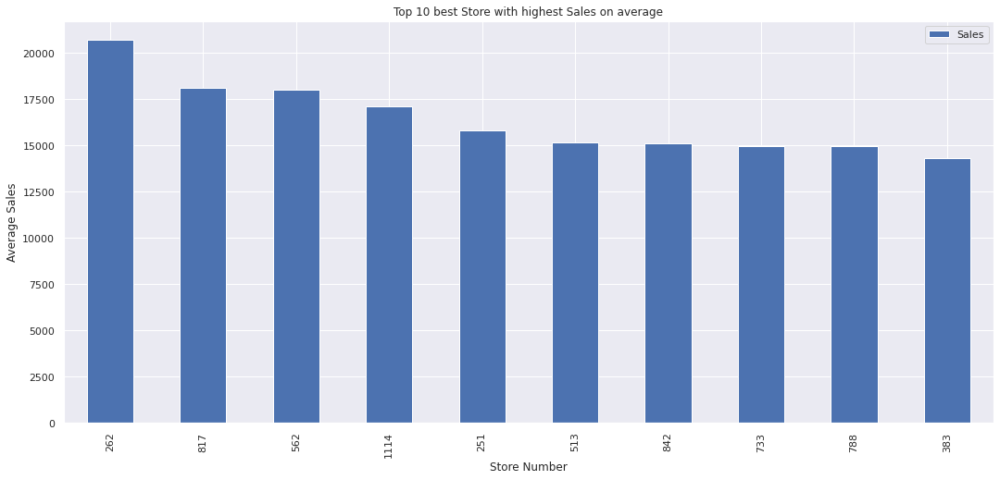

In [ ]:
fig, ax = plt.subplots(figsize = (18, 8))

train_df.groupby('Store').agg({'Sales': 'mean'})['Sales'].nlargest(10).plot.bar()
plt.xlabel('Store Number')
plt.ylabel('Average Sales')
plt.title('Top 10 best Store with highest Sales on average')
plt.legend()
plt.show()

## Top 10 Most visited stores by Customers- Store with highest sales on average

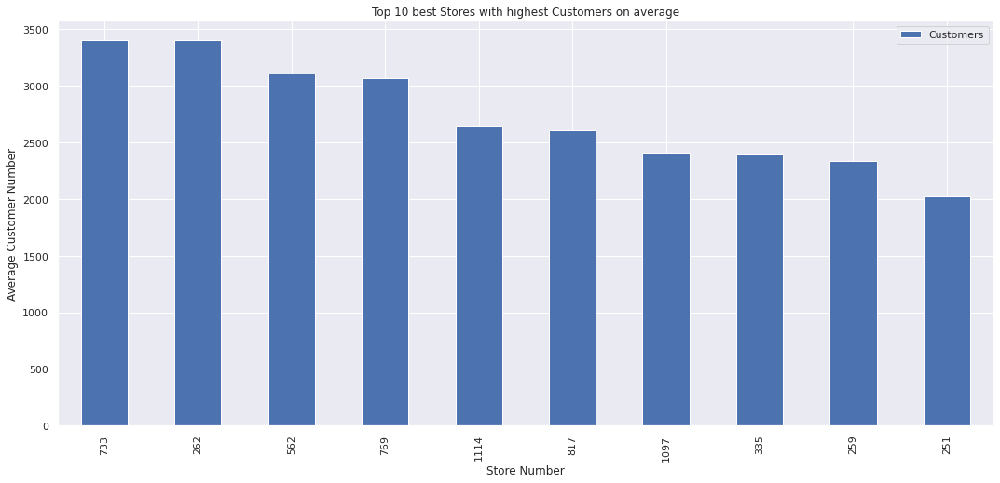

In [ ]:
fig, ax = plt.subplots(figsize = (18, 8))

train_df.groupby('Store').agg({'Customers': 'mean'})['Customers'].nlargest(10).plot.bar()
plt.xlabel('Store Number')
plt.ylabel('Average Customer Number')
plt.title('Top 10 best Stores with highest Customers on average')
plt.legend()
plt.show()

It's noting that the store 262 has the highest Sales on average follow by 817 and 562.However, the store 733 is the most crowded or the most visited by Customers follow by the store 262. But ranked as the 7th top performer on average regardless been the most visited one.

## Top 10 low Performer - Store with the lowest Sales::

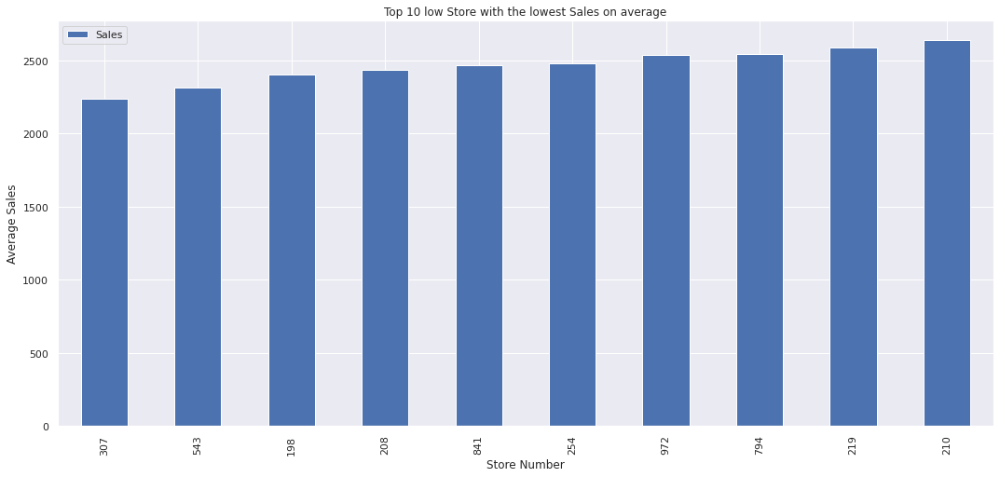

In [ ]:
fig, ax = plt.subplots(figsize = (18, 8))

train_df.groupby('Store').agg({'Sales': 'mean'})['Sales'].nsmallest(10).plot.bar()
plt.xlabel('Store Number')
plt.ylabel('Average Sales')
plt.title('Top 10 low Store with the lowest Sales on average')
plt.legend()
plt.show()

As seen above the store 307 is the low performer amomg all of them follow by the sore 543. Managers need to spend more time at that score to understand why that store is the low performer, and what factors lead to that result.


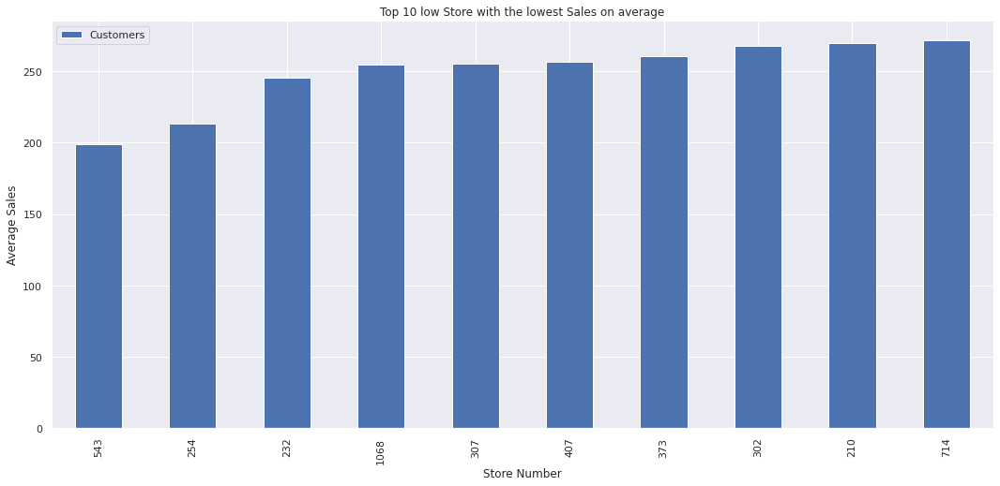

In [ ]:
fig, ax = plt.subplots(figsize = (18, 8))

train_df.groupby('Store').agg({'Customers': 'mean'})['Customers'].nsmallest(10).plot.bar()
plt.xlabel('Store Number')
plt.ylabel('Average Sales')
plt.title('Top 10 low Store with the lowest Sales on average')
plt.legend()
plt.show()

Not surprisingly, the store 543 is the least visit by customers and is also the second low performer amongst all of them.::

##End of Part 1 - EDA (Exploratory Data Analysis)

### *   Project Done by Arnaud Davy M.M


